## Imports and Helper Functions

In [58]:
import pandas as pd
import mplleaflet
import mapclassify
import geopandas as gpd
from geopandas import GeoDataFrame
import matplotlib.pyplot as plt
import numpy as np

# Replace any number of spaces with just a single space
def refineSpaces(x):
    return x.replace('\s+', ' ', regex=True)

# Remove leading and trailing white space
def removeExcessWhitespace(x):
    return x.str.strip()

# Convert the string to uppercase
def toUpper(x):
    return x.str.upper()


In [59]:
openmaps = pd.read_csv('data/csv/census/nyc-median-income-2017.csv')

In [60]:
openmaps.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1795 entries, 0 to 1794
Columns: 243 entries, Id to Median income (dollars); Margin of Error; NONFAMILY HOUSEHOLDS - Nonfamily households - Male householder - Not living alone
dtypes: int64(75), object(168)
memory usage: 3.3+ MB


## Define what data you want

In [61]:
censusDataPath = 'data/csv/census/nyc-median-income-2017.csv' # path to the census data you want to analyze
censusDataColumn = 'Median income (dollars); Estimate; Households' # column in the census data set to zone and color on the map

violationDataPath = 'data/Parking_Violations_Issued_-_Fiscal_Year_2023.csv'

legendTitle = 'Median Household Income, Thousands of USD'
mapTitle = 'NYC Median Household Income vs Parking Violations - 2017'

imageName = 'generated/median-income-2017.png'
htmlName = 'generated/median-income-2017.html'


In [62]:
violations = pd.read_csv(violationDataPath, low_memory=False)

In [63]:
violations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4636822 entries, 0 to 4636821
Data columns (total 43 columns):
 #   Column                             Dtype  
---  ------                             -----  
 0   Summons Number                     int64  
 1   Plate ID                           object 
 2   Registration State                 object 
 3   Plate Type                         object 
 4   Issue Date                         object 
 5   Violation Code                     int64  
 6   Vehicle Body Type                  object 
 7   Vehicle Make                       object 
 8   Issuing Agency                     object 
 9   Street Code1                       int64  
 10  Street Code2                       int64  
 11  Street Code3                       int64  
 12  Vehicle Expiration Date            int64  
 13  Violation Location                 float64
 14  Violation Precinct                 int64  
 15  Issuer Precinct                    int64  
 16  Issuer Code       

In [64]:
violations.head()

,Summons Number,Plate ID,Registration State,Plate Type,Issue Date,Violation Code,Vehicle Body Type,Vehicle Make,Issuing Agency,Street Code1,...,Vehicle Color,Unregistered Vehicle?,Vehicle Year,Meter Number,Feet From Curb,Violation Post Code,Violation Description,No Standing or Stopping Violation,Hydrant Violation,Double Parking Violation
0,1484697303,JER1863,NY,PAS,06/10/2022,67,SDN,TOYOT,P,34330,...,BLK,0.0,2004,-,0,NaN,NaN,NaN,NaN,NaN
1,1484697315,KEV4487,NY,PAS,06/13/2022,51,SUBN,JEEP,K,34310,...,GRAY,0.0,2017,-,0,NaN,NaN,NaN,NaN,NaN
2,1484697625,H73NYD,NJ,PAS,06/19/2022,63,SDN,JEEP,N,30640,...,GRAY,0.0,0,-,0,NaN,NaN,NaN,NaN,NaN
3,1484697674,GJC9296,NY,PAS,06/19/2022,63,SUBN,LEXUS,N,30640,...,NaN,0.0,0,-,0,NaN,NaN,NaN,NaN,NaN
4,1484697686,M51PUV,NJ,PAS,06/19/2022,63,SDN,HYUND,N,30640,...,BLUE,0.0,0,-,0,NaN,NaN,NaN,NaN,NaN


## Data Cleaning

In [65]:
#violations = pd.read_csv(violationDataPath, low_memory=False)
violations[['House Number', 'Street Name']] = violations[['House Number', 'Street Name']].apply(refineSpaces)
violations[['House Number', 'Street Name']] = violations[['House Number', 'Street Name']].apply(removeExcessWhitespace)
violations[['House Number', 'Street Name']] = violations[['House Number', 'Street Name']].apply(toUpper)

openmaps = pd.read_csv('data/csv/nyc-address-to-zip-code.csv')
openmaps[['NUMBER', 'STREET']] = openmaps[['NUMBER', 'STREET']].apply(refineSpaces)
openmaps[['NUMBER', 'STREET']] = openmaps[['NUMBER', 'STREET']].apply(removeExcessWhitespace)
openmaps[['NUMBER', 'STREET']] = openmaps[['NUMBER', 'STREET']].apply(toUpper)

# read in shape data and turn zcta(zip code) into an int
shapes = gpd.read_file('data/shp/nyc-shape-by-zip')
shapes['zcta'] = shapes['zcta'].astype(int)

# read in census data and ensure that rows have numeric data
censusData = pd.read_csv(censusDataPath)
censusData = censusData[pd.to_numeric(censusData[censusDataColumn], errors='coerce').notnull()]

print("Done cleaning data.")


Done cleaning data.


# Merge our dataframes together

In [66]:
# merge in zip code based on address
merged = pd.merge(violations, openmaps,  how='inner', left_on=['House Number', 'Street Name'], right_on = ['NUMBER','STREET'])
print(merged.shape)

# merge in shapefile stuff on zip code
merged = pd.merge(merged, shapes, how='inner', left_on=['POSTCODE'], right_on=['zcta'])

# merge in census data based on zip code
merged = pd.merge(merged, censusData[['Id2', censusDataColumn]], how='inner', left_on=['POSTCODE'], right_on=['Id2'])

merged.to_csv("generated/nyc-merged-data-all.csv")

print("Done merging data frames.")


(859953, 54)
Done merging data frames.


In [5]:
merged = pd.read_csv("generated/nyc-merged-data-all.csv", low_memory=False)

In [67]:
merged.head()

,Summons Number,Plate ID,Registration State,Plate Type,Issue Date,Violation Code,Vehicle Body Type,Vehicle Make,Issuing Agency,Street Code1,...,REGION,POSTCODE,ID,HASH,zcta,bcode,note,geometry,Id2,Median income (dollars); Estimate; Households
0,1484697625,H73NYD,NJ,PAS,06/19/2022,63,SDN,JEEP,N,30640,...,NaN,10038.0,1001220.0,a7f2819075ee79ec,10038,36061,None,"POLYGON ((-73.99753 40.71402, -73.99739 40.713...",10038,85032
1,1484697674,GJC9296,NY,PAS,06/19/2022,63,SUBN,LEXUS,N,30640,...,NaN,10038.0,1001220.0,a7f2819075ee79ec,10038,36061,None,"POLYGON ((-73.99753 40.71402, -73.99739 40.713...",10038,85032
2,1484697686,M51PUV,NJ,PAS,06/19/2022,63,SDN,HYUND,N,30640,...,NaN,10038.0,1001220.0,a7f2819075ee79ec,10038,36061,None,"POLYGON ((-73.99753 40.71402, -73.99739 40.713...",10038,85032
3,1484697698,H73NYD,NJ,PAS,06/23/2022,63,NaN,JEEP,K,30640,...,NaN,10038.0,1001220.0,a7f2819075ee79ec,10038,36061,None,"POLYGON ((-73.99753 40.71402, -73.99739 40.713...",10038,85032
4,1484697728,M51PUV,NJ,PAS,06/23/2022,63,NaN,HYUND,K,30640,...,NaN,10038.0,1001220.0,a7f2819075ee79ec,10038,36061,None,"POLYGON ((-73.99753 40.71402, -73.99739 40.713...",10038,85032


In [68]:
merged = merged.rename(columns={"Issue Date":"IssueDate"})

In [69]:
merged['IssueDate'] = pd.to_datetime(merged.IssueDate)

In [70]:
merged['month'] = pd.DatetimeIndex(merged['IssueDate']).month

In [82]:
July_df = merged[merged['month'] == 7]

In [87]:
July_df_8 = July_df[July_df['IssueDate'] == '2022-07-08']

In [88]:
July_df_25 = July_df[July_df['IssueDate'] == '2022-07-25']

In [162]:
July_df_28 = July_df[July_df['IssueDate'] == '2022-07-28']

In [90]:
a = [July_df_8, July_df_25]

In [91]:
July_8_25 = pd.concat(a)

In [163]:
July_df_28['Violation Time']

197       0837P
198       0839P
199       0840P
558       0107P
604       0835P
          ...  
852114    1139A
852115    1140A
852116    1142A
852117    1143A
852786    0753A
Name: Violation Time, Length: 13848, dtype: object

In [ ]:
1 = July_df_28

In [158]:
a = (July_df_28.loc[July_df_28['Violation Time'].str.slice(start=0, stop = 2) == "00"])["Violation Time"] = '12' + July_df_28['Violation Time'].str.slice(start=2, stop = 5)

/var/folders/33/zfjl4vq93zzb6tfl8kq0cg6m0000gn/T/ipykernel_67386/1960910005.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  a = (July_df_28.loc[July_df_28['Violation Time'].str.slice(start=0, stop = 2) == "00"])["Violation Time"] = '12' + July_df_28['Violation Time'].str.slice(start=2, stop = 5)


In [150]:
a["Violation Time"]

38677     0001AM
40967     0004AM
40968     0006AM
65421     0008AM
66591     0004AM
           ...  
679954    0027AM
687216    0019AM
687218    0020AM
728341    0002AM
758568    0058AM
Name: Violation Time, Length: 124, dtype: object

In [144]:
July_df_28['Violation Time'] =  July_df_28['Violation Time'].astype(str) + 'M'

/var/folders/33/zfjl4vq93zzb6tfl8kq0cg6m0000gn/T/ipykernel_67386/2183046642.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  July_df_28['Violation Time'] =  July_df_28['Violation Time'].astype(str) + 'M'


In [72]:
July_1 = merged[merged['IssueDate'] == '2022-07-02']

In [73]:
day_id = [i for i in range(1, 32)]
day_id[0] = "01"
day_id[1] = "02"
day_id[2] = "03"
day_id[3] = "04"
day_id[4] = "05"
day_id[5] = "06"
day_id[6] = "07"
day_id[7] = "08"
day_id[8] = "09"

In [74]:
Date_month = "2022-07-"

/Users/taolueyang/opt/anaconda3/lib/python3.9/site-packages/geopandas/plotting.py:673: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)


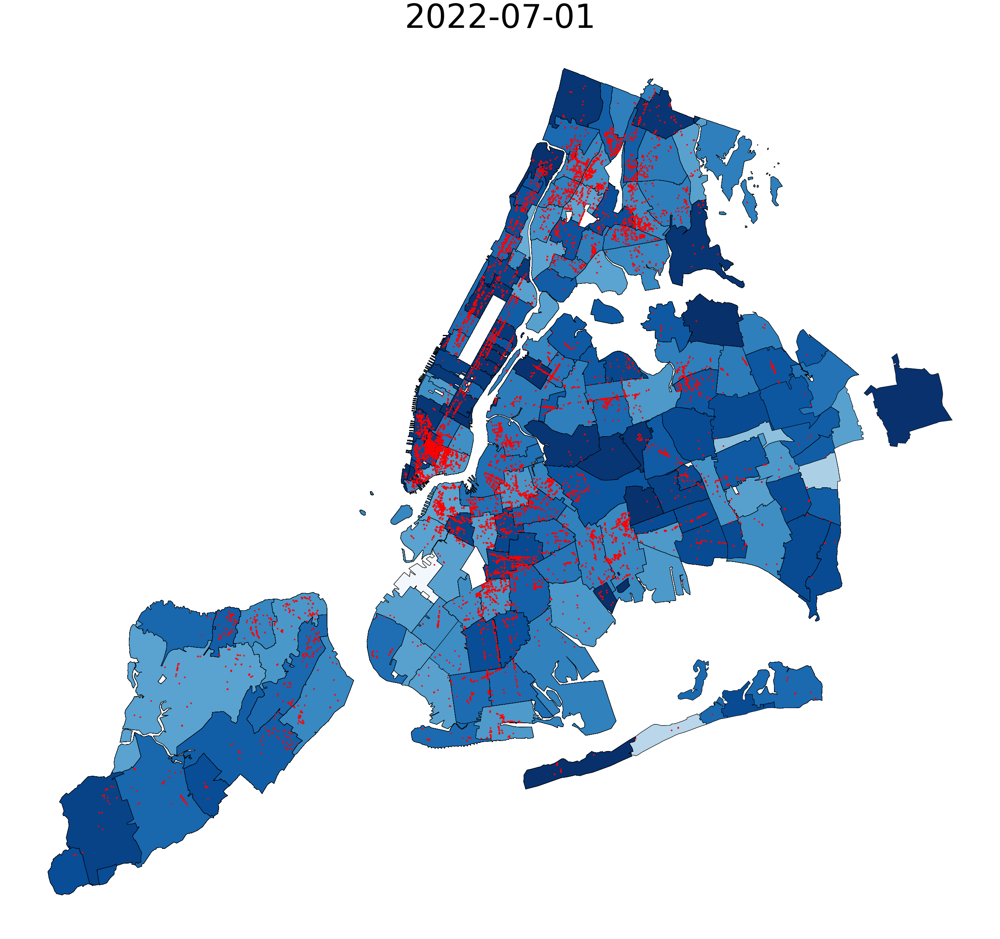

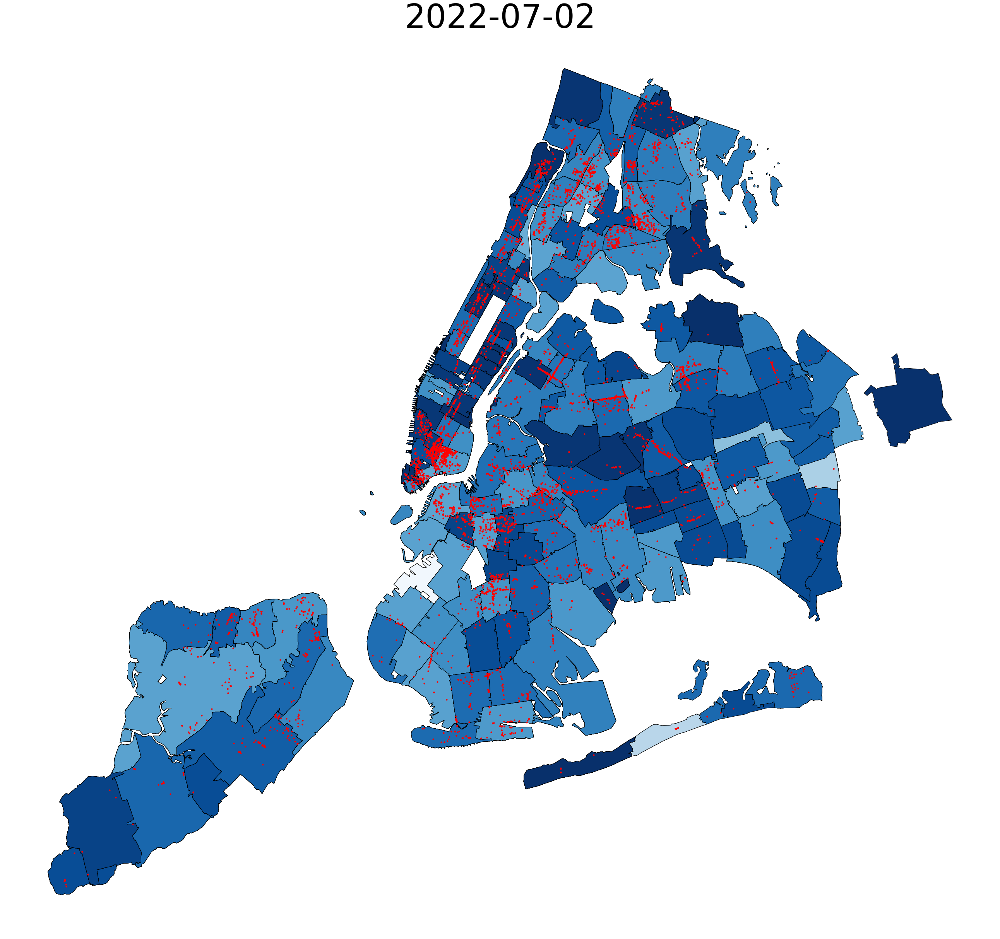

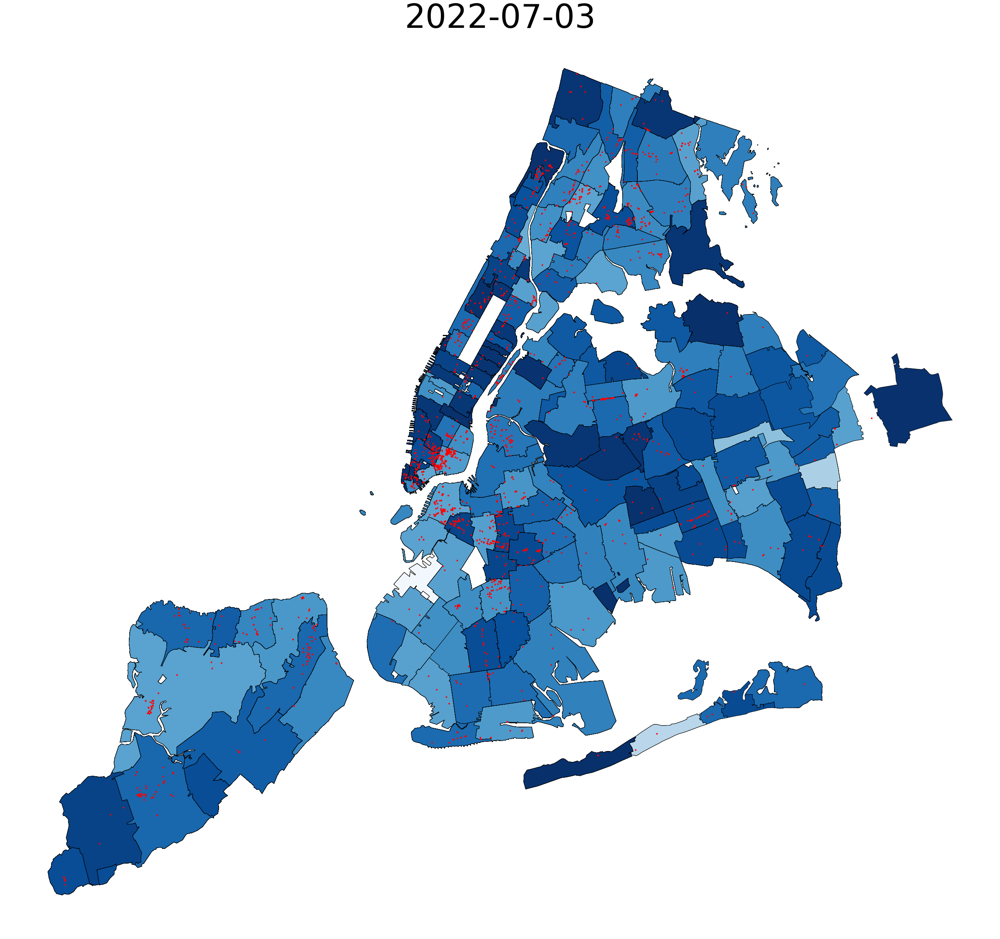

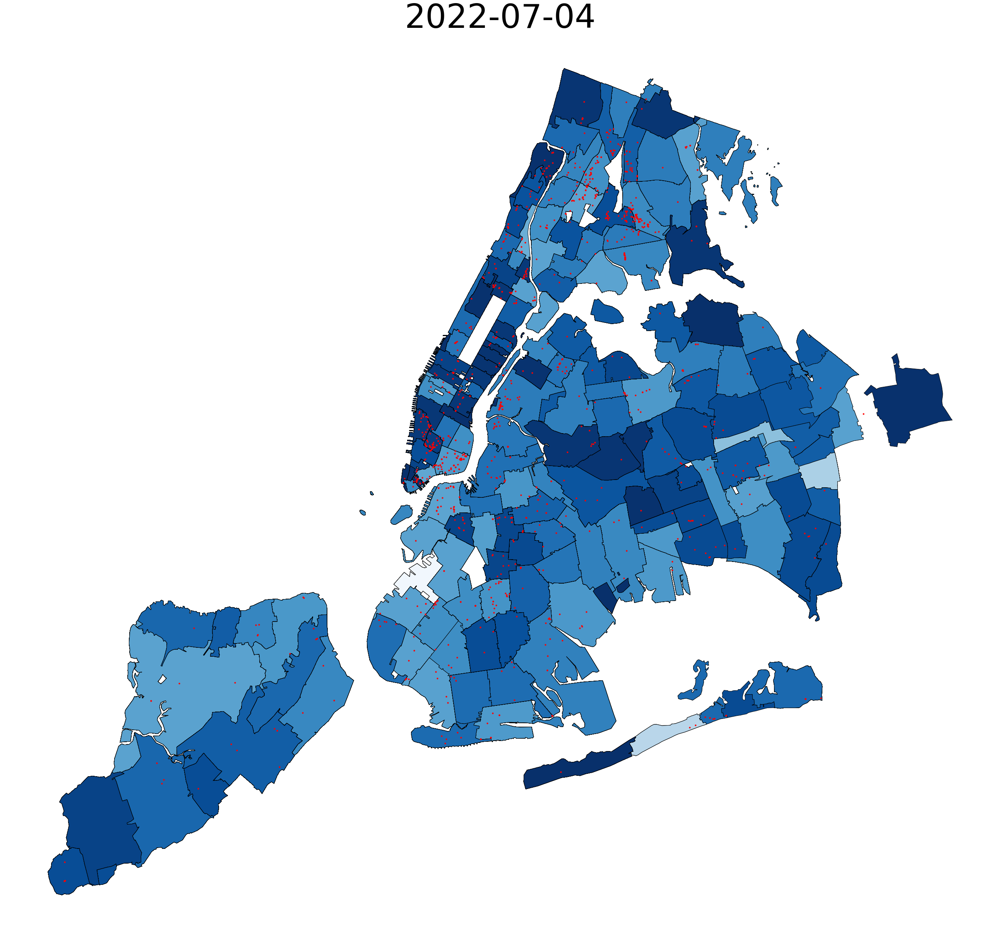

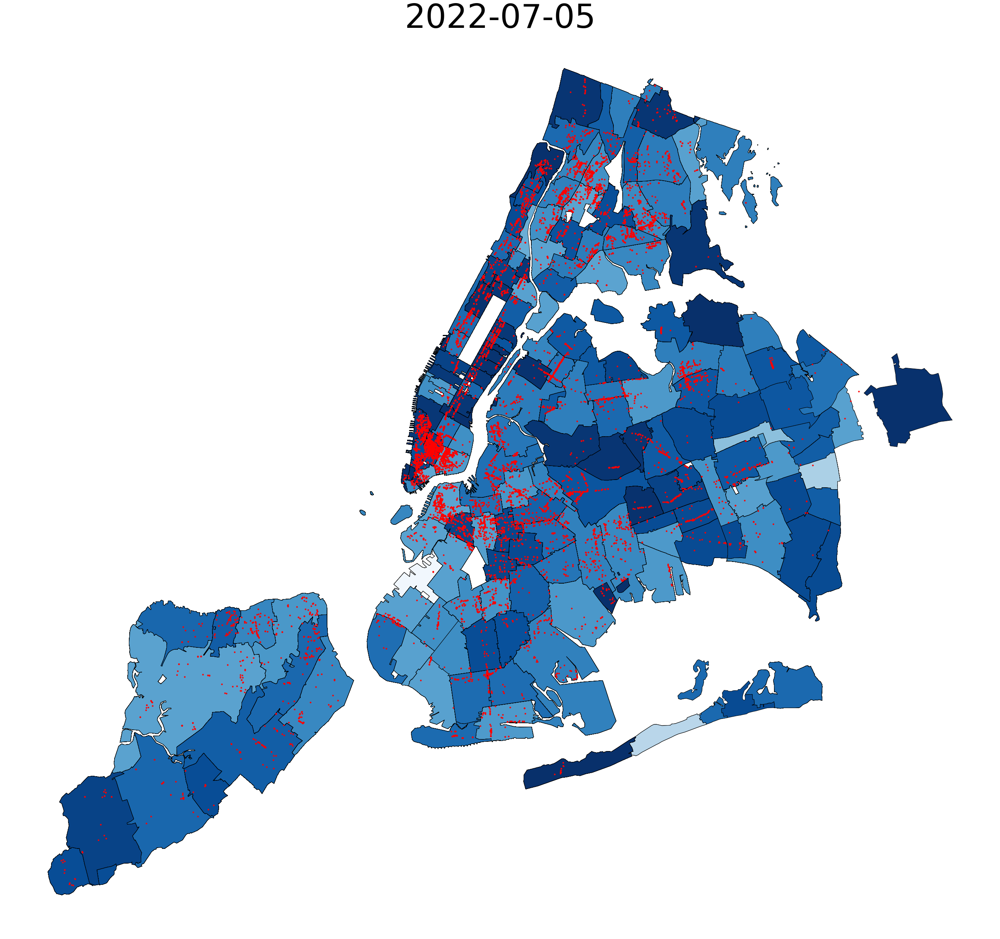

...

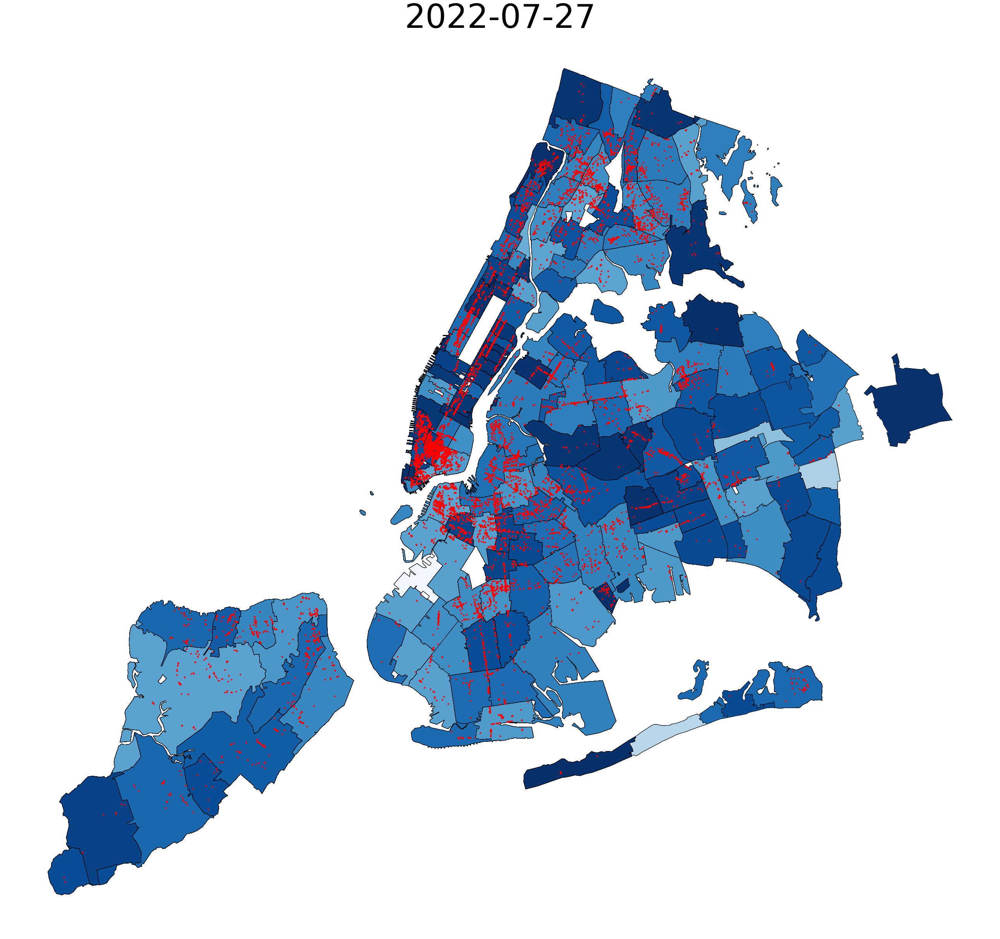

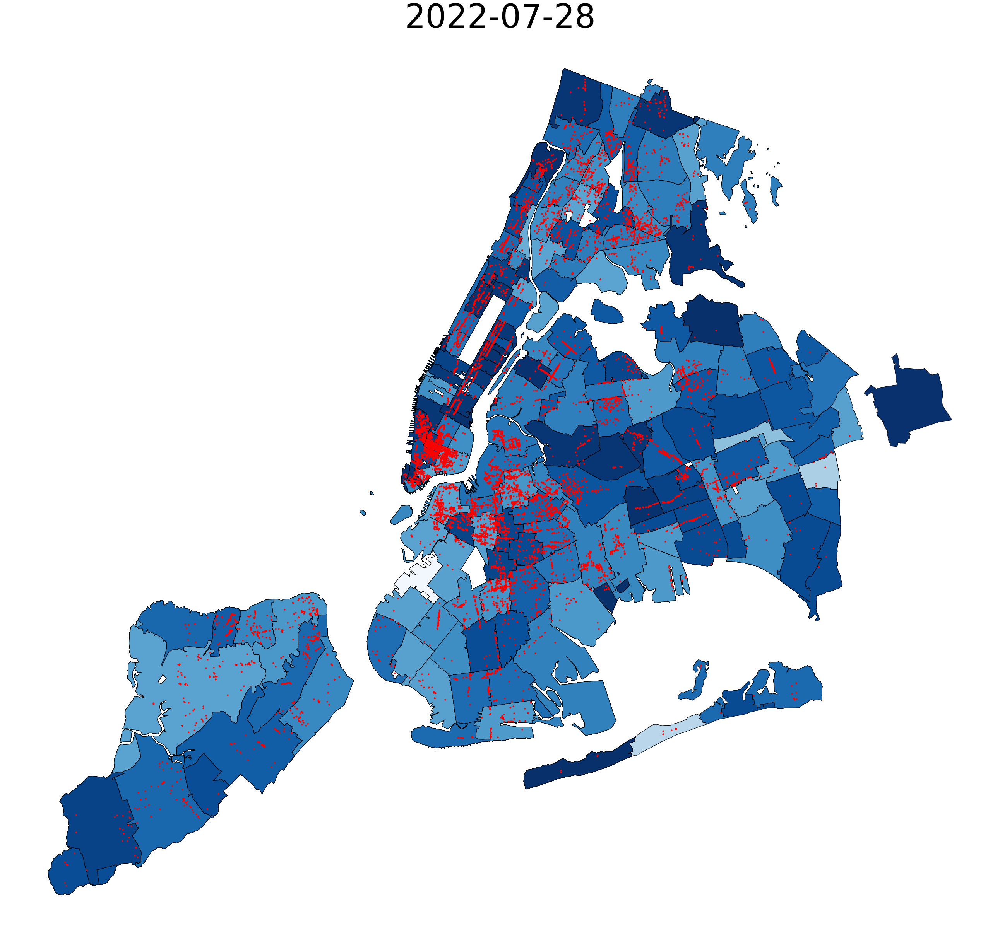

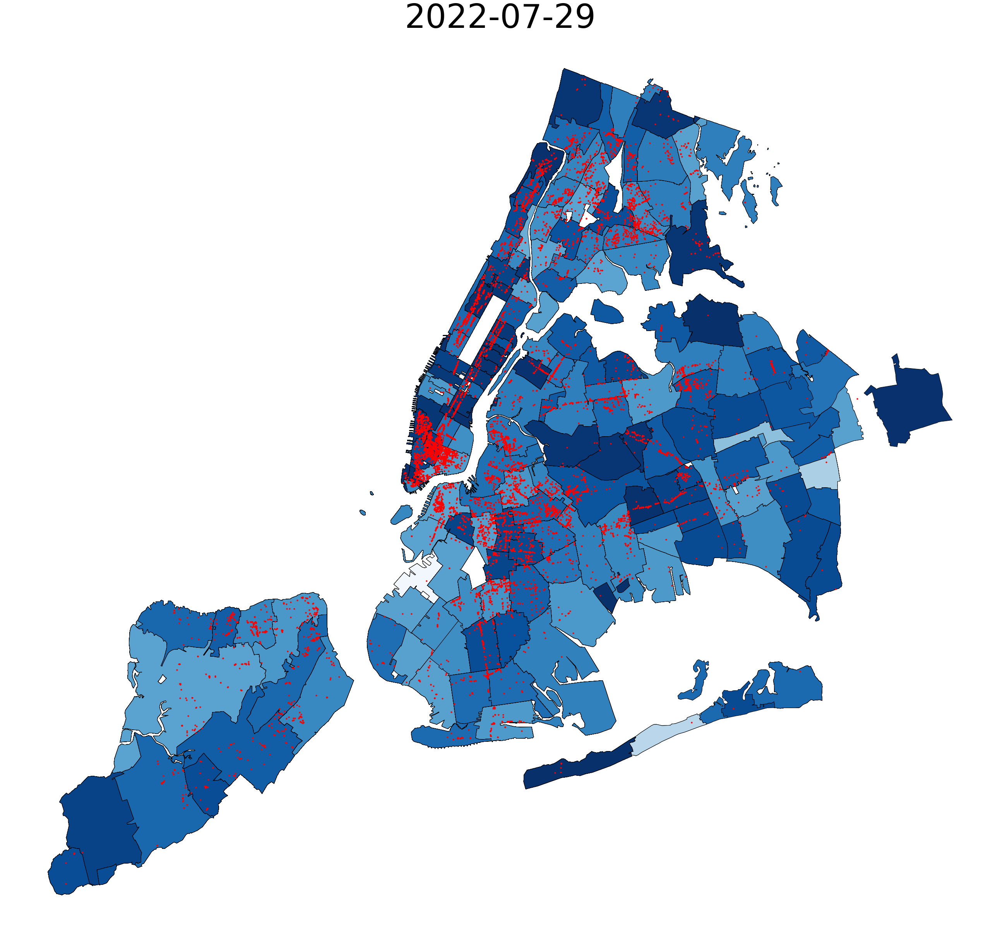

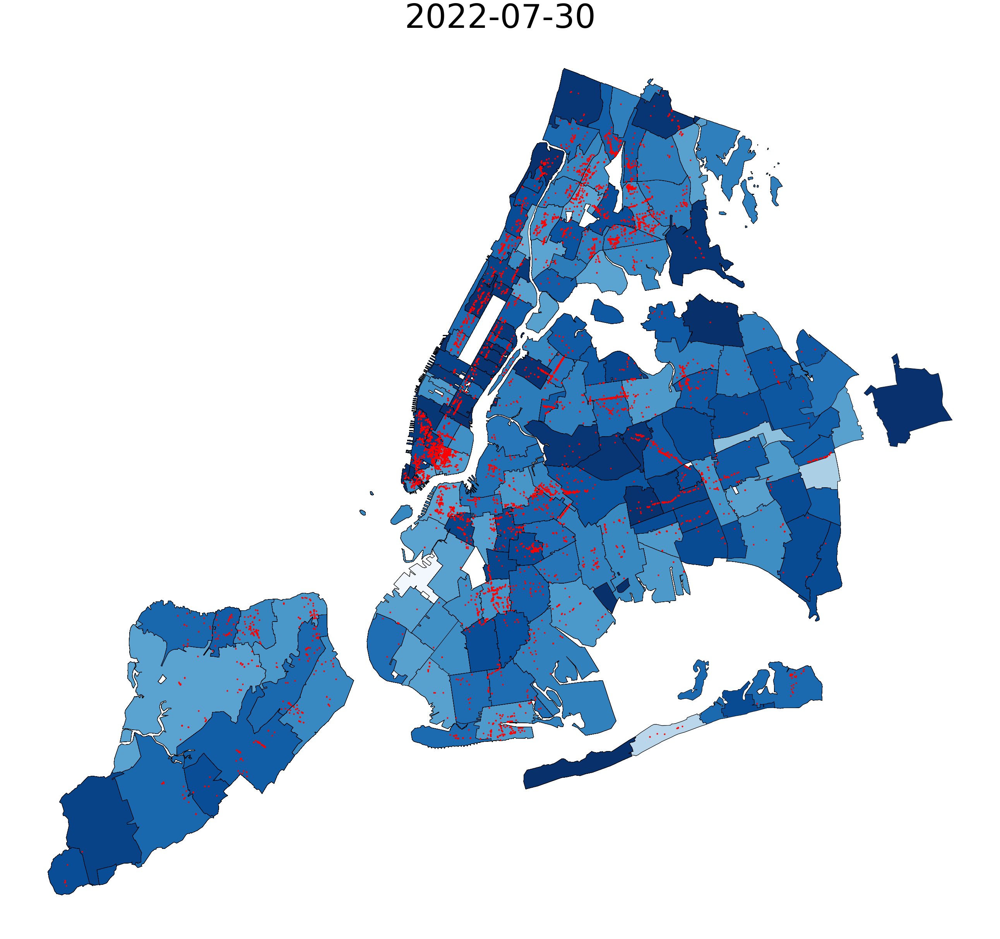

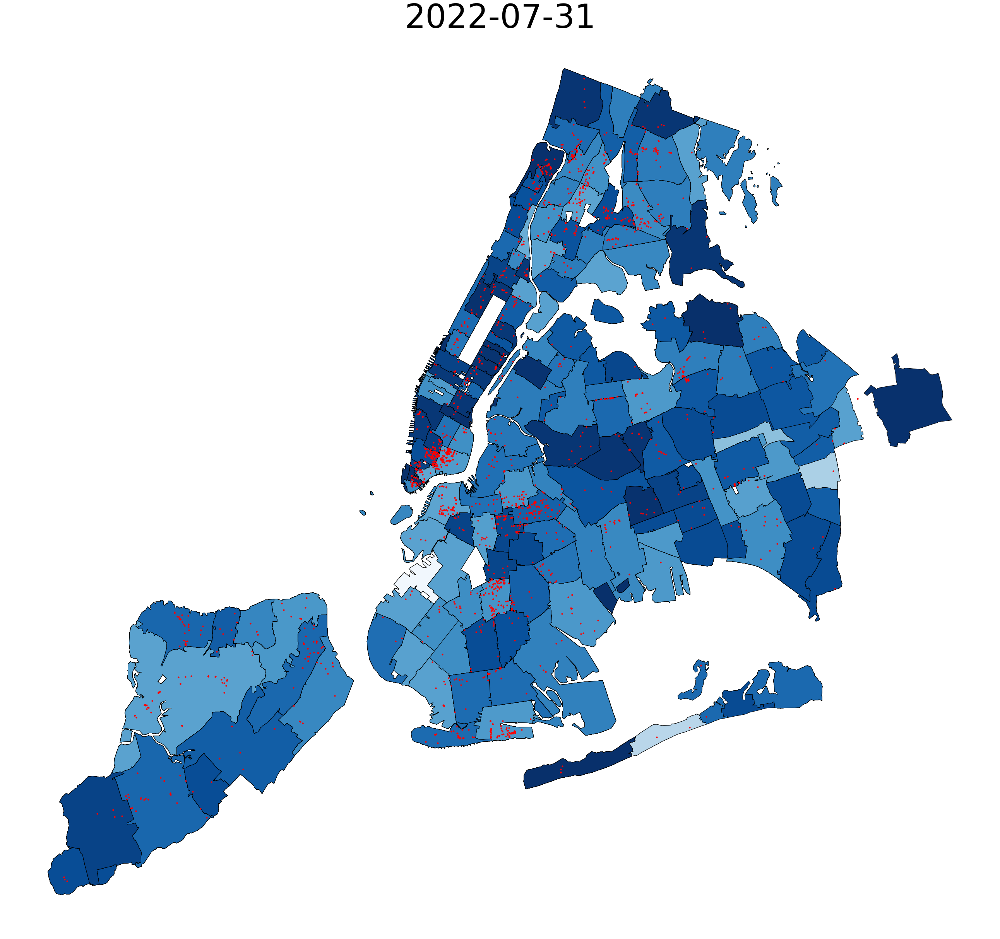

In [93]:
for i in day_id:
    date_id = Date_month + str(i)
    pic_name = date_id + ".png"
    July_df_x = merged[merged['IssueDate'] == date_id]
    
    # legend cannot be shown to mplleaflet. comment out the first one if youre plotting to mflleaflet
    ax = GeoDataFrame(July_8_25).plot(cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black')
    #ax = GeoDataFrame(merged).plot(column=censusDataColumn,  cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black')

    ax = plt.scatter(July_df_x['LON'], July_df_x['LAT'], marker='o', s=10, color="red")

    plt.axis('off')

    figure = ax.figure
    figure.suptitle(date_id, fontsize=85)
    figure.tight_layout()
    figure.subplots_adjust(top=1.0)

    figure.savefig(imageName, dpi=150)
    plt.savefig("./New-York-City-Parking-Violations/Time_Series_Generated/" + pic_name)
    #mplleaflet.save_html(fig=figure, fileobj=htmlName)

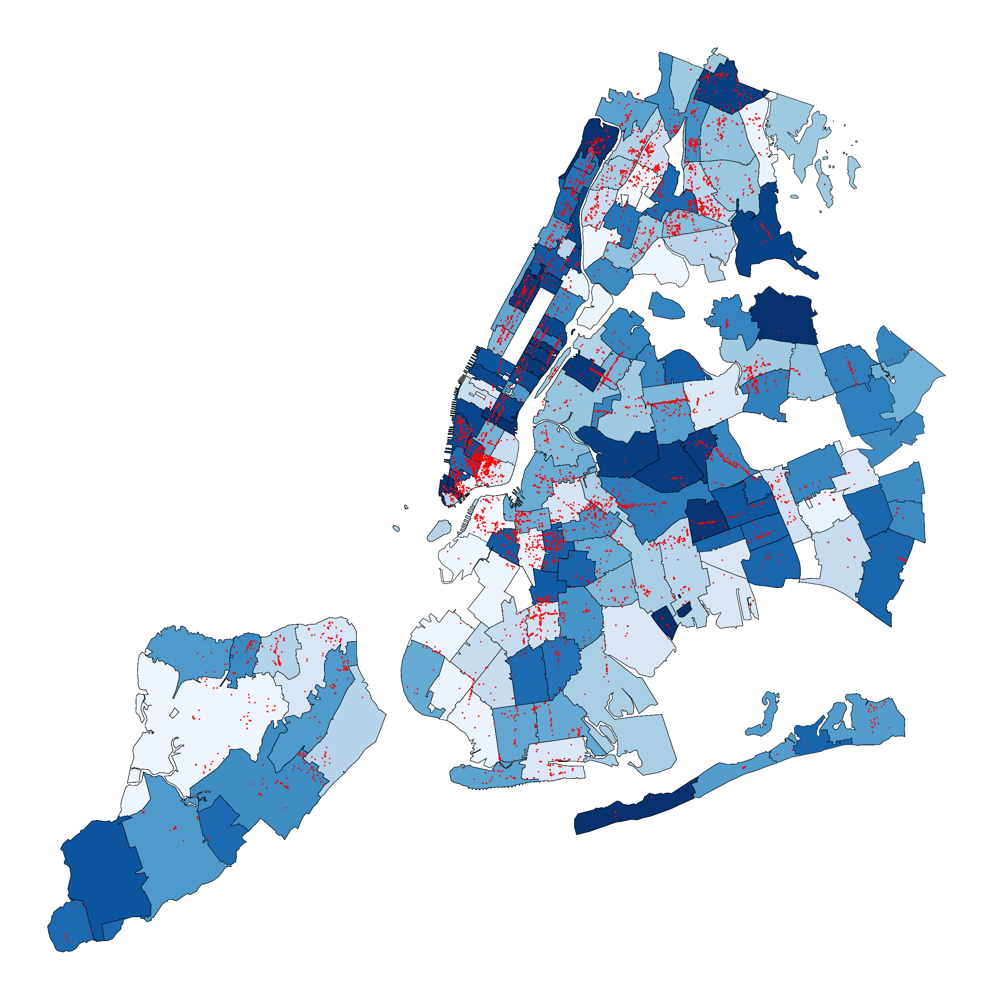

In [37]:
# legend cannot be shown to mplleaflet. comment out the first one if youre plotting to mflleaflet
ax = GeoDataFrame(July_1).plot(cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black',legend=True, legend_kwds={'title': legendTitle, 'loc': 'upper left', 'title_fontsize':30, 'markerscale': 3, 'prop': {'size': 30}})
#ax = GeoDataFrame(merged).plot(column=censusDataColumn,  cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black')

ax = plt.scatter(July_1['LON'], July_1['LAT'], marker='o', s=10, color="red")

plt.axis('off')

figure = ax.figure
#figure.suptitle(mapTitle, fontsize=85)
figure.tight_layout()
figure.subplots_adjust(top=1.0)

figure.savefig(imageName, dpi=150)
plt.show()
#mplleaflet.save_html(fig=figure, fileobj=htmlName)

# Plot violations and zip codes, then color

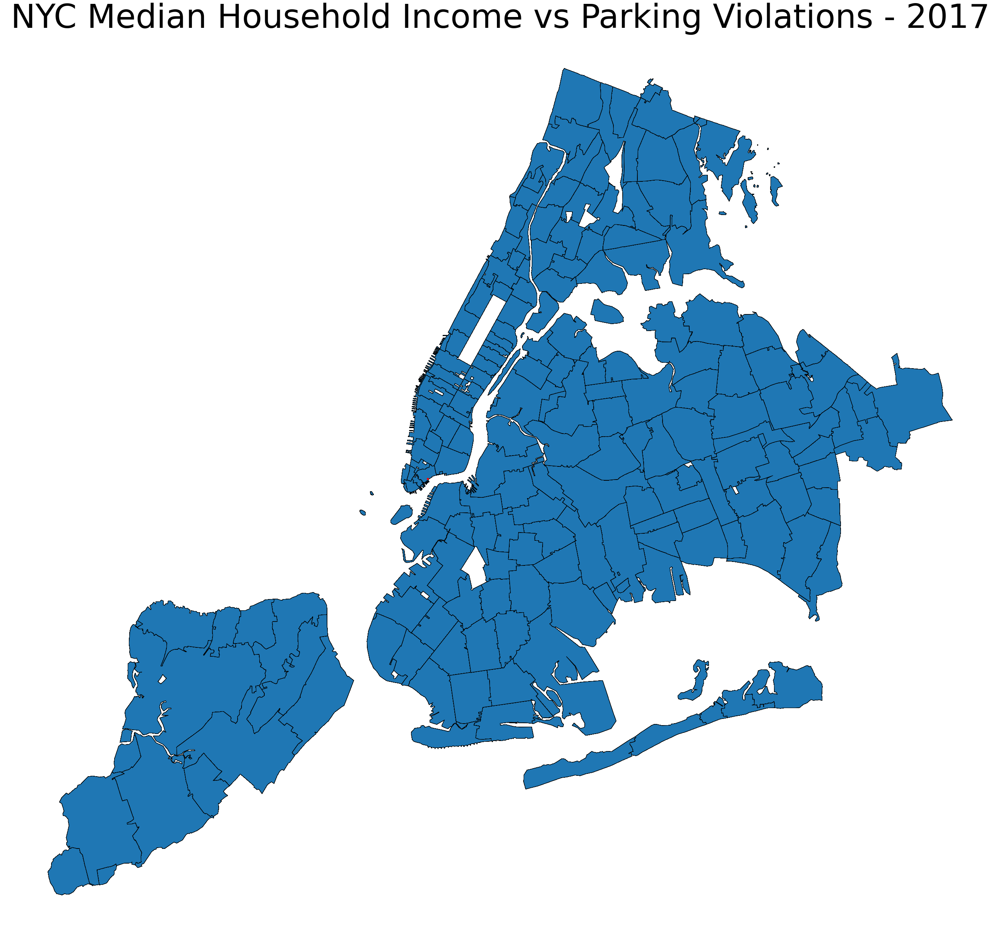

In [10]:
# legend cannot be shown to mplleaflet. comment out the first one if youre plotting to mflleaflet
ax = GeoDataFrame(merged).plot(scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black', legend=True, legend_kwds={'title': legendTitle, 'loc': 'upper left', 'title_fontsize':30, 'markerscale': 3, 'prop': {'size': 30}})
#ax = GeoDataFrame(merged).plot(column=censusDataColumn,  cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black')

ax = plt.scatter(merged['LON'][0], merged['LAT'][0], marker='o', s=20, color="red")

plt.axis('off')

figure = ax.figure
#figure.suptitle(mapTitle, fontsize=85)
figure.tight_layout()
figure.subplots_adjust(top=1.0)

figure.savefig(imageName, dpi=150)
plt.show()
#mplleaflet.save_html(fig=figure, fileobj=htmlName)


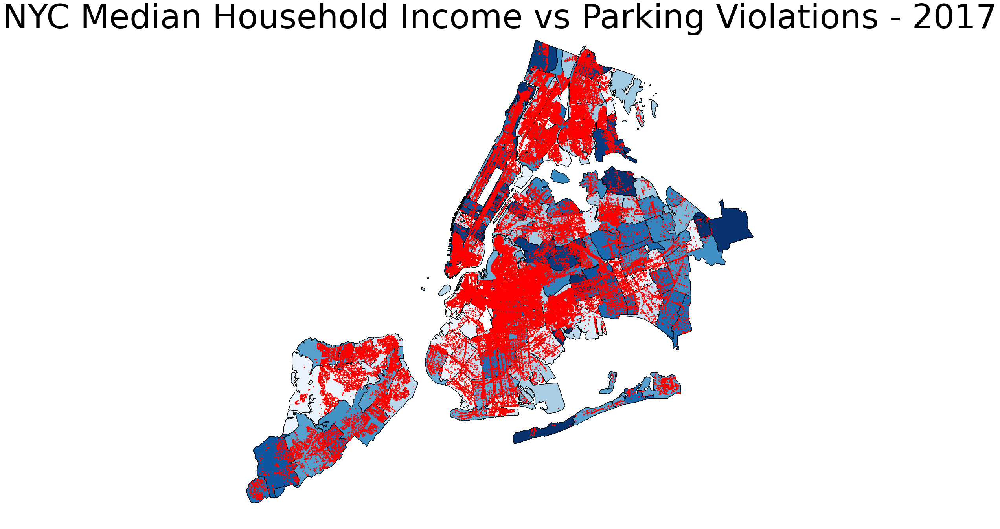

In [20]:
# legend cannot be shown to mplleaflet. comment out the first one if youre plotting to mflleaflet
ax = GeoDataFrame(merged).plot(cmap='Blues', scheme='QUANTILES', k=10, figsize=(20, 20), edgecolor='black', legend=True, legend_kwds={'title': legendTitle, 'loc': 'upper left', 'title_fontsize':30, 'markerscale': 3, 'prop': {'size': 30}})
#ax = GeoDataFrame(merged).plot(column=censusDataColumn,  cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black')

ax = plt.scatter(merged['LON'], merged['LAT'], marker='o', s=3, color="red")

plt.axis('off')

figure = ax.figure
#figure.suptitle(mapTitle, fontsize=85)
figure.tight_layout()
figure.subplots_adjust(top=1.0)

figure.savefig(imageName, dpi=150)
plt.show()
#mplleaflet.save_html(fig=figure, fileobj=htmlName)

In [15]:
plt.show()

In [16]:
del merged['Median income (dollars); Estimate; Households']

In [18]:
merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17234 entries, 0 to 17233
Data columns (total 60 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   Unnamed: 0                         17234 non-null  int64   
 1   Summons Number                     17234 non-null  int64   
 2   Plate ID                           17232 non-null  object  
 3   Registration State                 17234 non-null  object  
 4   Plate Type                         17234 non-null  object  
 5   Issue Date                         17234 non-null  object  
 6   Violation Code                     17234 non-null  int64   
 7   Vehicle Body Type                  17155 non-null  object  
 8   Vehicle Make                       17115 non-null  object  
 9   Issuing Agency                     17234 non-null  object  
 10  Street Code1                       17234 non-null  int64   
 11  Street Code2                       17234 

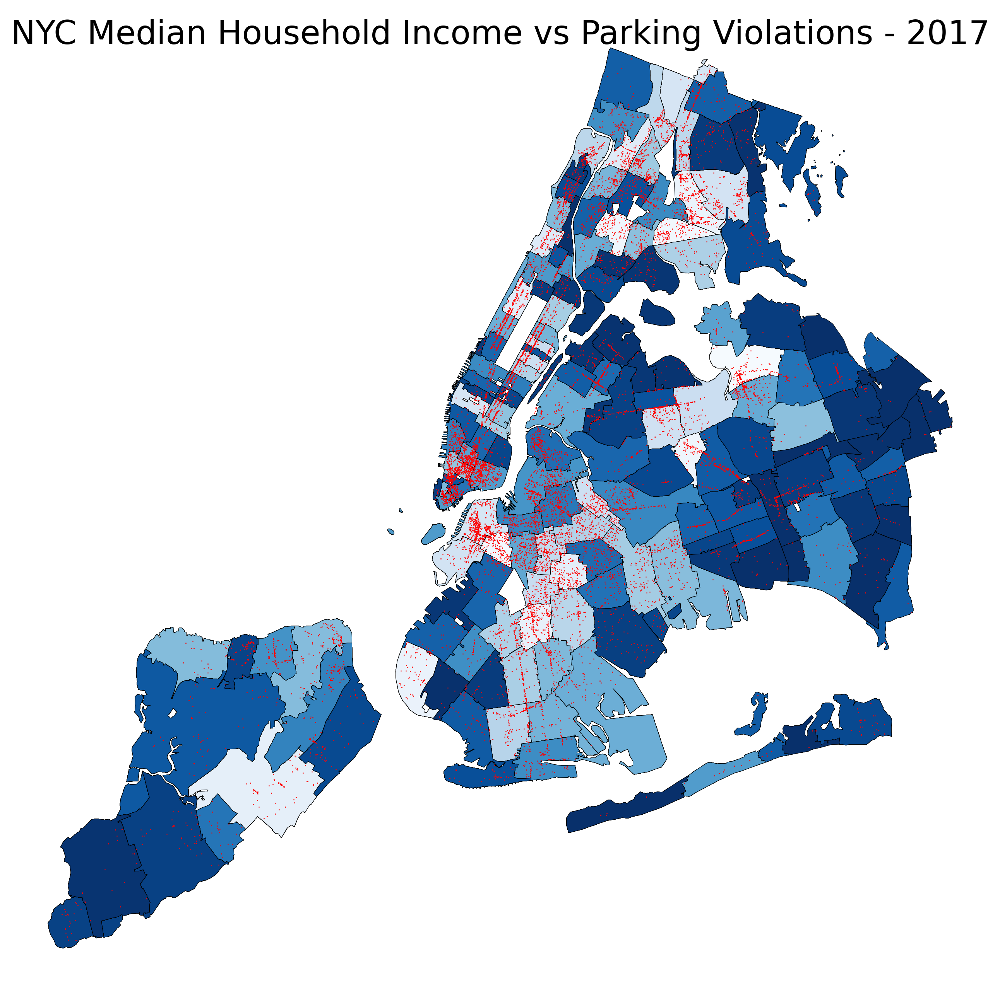

In [20]:
# legend cannot be shown to mplleaflet. comment out the first one if youre plotting to mflleaflet
ax = GeoDataFrame(merged).plot(cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black', legend=True, legend_kwds={'title': legendTitle, 'loc': 'upper left', 'title_fontsize':30, 'markerscale': 3, 'prop': {'size': 30}})
#ax = GeoDataFrame(merged).plot(column=censusDataColumn,  cmap='Blues', scheme='QUANTILES', k=10, figsize=(36, 36), edgecolor='black')

ax = plt.scatter(merged['LON'], merged['LAT'], marker='o', s=3, color="red")

plt.axis('off')

figure = ax.figure
#figure.suptitle(mapTitle, fontsize=85)
figure.tight_layout()
figure.subplots_adjust(top=1.0)

figure.savefig(imageName, dpi=150)
plt.show()
#mplleaflet.save_html(fig=figure, fileobj=htmlName)